In [ ]:
import pandas as pd
from google.colab import files
uploaded = files.upload()

import io
df = pd.read_csv(io.BytesIO(uploaded['walmart.csv']))




Saving walmart.csv to walmart.csv


# Preprocessing of Data

In [ ]:
# Import necessary libraries
import pandas as pd  # For data manipulation
import numpy as np   # For numerical computations

# Load the dataset
df = pd.read_csv('walmart.csv')  # Load the data from the CSV file



In [ ]:
df.describe()

,Store,Dept,Weekly_Sales,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,Size
count,282451.000000,282451.000000,282451.000000,282451.000000,282451.000000,100520.000000,74232.000000,91521.000000,90031.000000,101029.000000,282451.000000,282451.000000,282451.000000
mean,22.193166,44.286138,15983.429692,60.113640,3.360300,7246.077559,3318.408122,1417.397841,3379.591745,4639.476021,171.207802,7.968098,136730.073220
std,12.782138,30.503641,22661.092494,18.446485,0.458602,8254.606267,9485.575898,9547.858949,6269.428446,6060.459590,39.160808,1.868070,61002.319363
min,1.000000,1.000000,-4988.940000,-2.060000,2.472000,0.270000,-265.760000,-29.100000,0.220000,135.160000,126.064000,3.879000,34875.000000
25%,11.000000,18.000000,2079.330000,46.780000,2.932000,2241.190000,40.960000,5.060000,508.100000,1877.810000,132.022667,6.891000,93638.000000
50%,22.000000,38.000000,7616.550000,62.150000,3.452000,5363.520000,191.820000,24.340000,1482.030000,3364.410000,182.350989,7.866000,140167.000000
75%,33.000000,74.000000,20245.745000,74.290000,3.737000,9235.590000,1919.790000,103.130000,3607.570000,5563.800000,212.464799,8.572000,202505.000000
max,45.000000,99.000000,693099.360000,100.140000,4.468000,88646.760000,104519.540000,141630.610000,67474.850000,108519.280000,227.232807,14.313000,219622.000000


In [ ]:

# Check for missing values in each column
df.isnull().sum()



Store                0
Dept                 0
Date                 0
Weekly_Sales         0
IsHoliday            0
Temperature          0
Fuel_Price           0
MarkDown1       181931
MarkDown2       208219
MarkDown3       190930
MarkDown4       192420
MarkDown5       181422
CPI                  0
Unemployment         0
Type                 0
Size                 0
dtype: int64

In [ ]:
# Fill missing values in 'MarkDown' columns with 0
df.fillna({'MarkDown1':0, 'MarkDown2':0, 'MarkDown3':0, 'MarkDown4':0, 'MarkDown5':0}, inplace=True)

In [ ]:

# Check for missing values in each column
df.isnull().sum()



Store           0
Dept            0
Date            0
Weekly_Sales    0
IsHoliday       0
Temperature     0
Fuel_Price      0
MarkDown1       0
MarkDown2       0
MarkDown3       0
MarkDown4       0
MarkDown5       0
CPI             0
Unemployment    0
Type            0
Size            0
dtype: int64

In [ ]:
# Convert the 'Date' column to datetime format
df['Date'] = pd.to_datetime(df['Date'])

In [ ]:
# Extract year, month, and day from the 'Date' column for further analysis
df['Year'] = df['Date'].dt.year
df['Month'] = df['Date'].dt.month
df['Day'] = df['Date'].dt.day


In [ ]:

# Normalize 'Weekly_Sales' column
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
df['Weekly_Sales'] = scaler.fit_transform(df['Weekly_Sales'].values.reshape(-1,1))


In [ ]:

# Encode boolean 'IsHoliday' column to integer
df['IsHoliday'] = df['IsHoliday'].astype(int)

# Remove duplicate rows
df.drop_duplicates(inplace=True)


In [ ]:
# Drop the 'Type' column if it's not needed for the analysis
df.drop(['Type'], axis=1, inplace=True)


In [ ]:
# Save the preprocessed data to a new CSV file
df.to_csv('walmart_preprocessed.csv', index=False)

In [ ]:
df.to_csv('/content/drive/My Drive/Colab Notebooks/walmart_preprocessed.csv', index=False)


# Finding appropriate model

## Exploratory Data Analysis (EDA)

In [ ]:
# Generate descriptive statistics for numerical columns
numerical_summary = df.describe()

# Count the frequency of unique values in categorical columns
# For this dataset, 'Store', 'Dept', 'Type', and 'IsHoliday' can be considered categorical
categorical_summary = df[['Store', 'Dept', 'IsHoliday']].astype('category').describe()

numerical_summary, categorical_summary


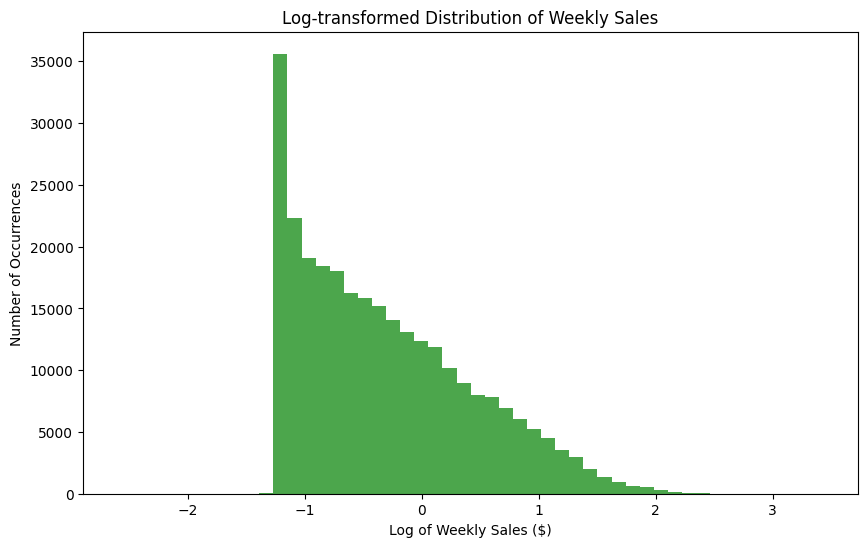

In [ ]:
# Import visualization library
import matplotlib.pyplot as plt

# Apply a logarithmic transformation to the Weekly_Sales column
# Adding a small constant because log transformation cannot be applied to 0 or negative values
df['Weekly_Sales_Log'] = np.log(df['Weekly_Sales'] + 1)

# Plot the histogram of the transformed Weekly_Sales column
plt.figure(figsize=(10, 6))
plt.hist(df['Weekly_Sales_Log'], bins=50, color='green', alpha=0.7)
plt.title('Log-transformed Distribution of Weekly Sales')
plt.xlabel('Log of Weekly Sales ($)')
plt.ylabel('Number of Occurrences')
plt.show()


<ipython-input-21-e69da118812f>:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  correlation_matrix = df.corr()


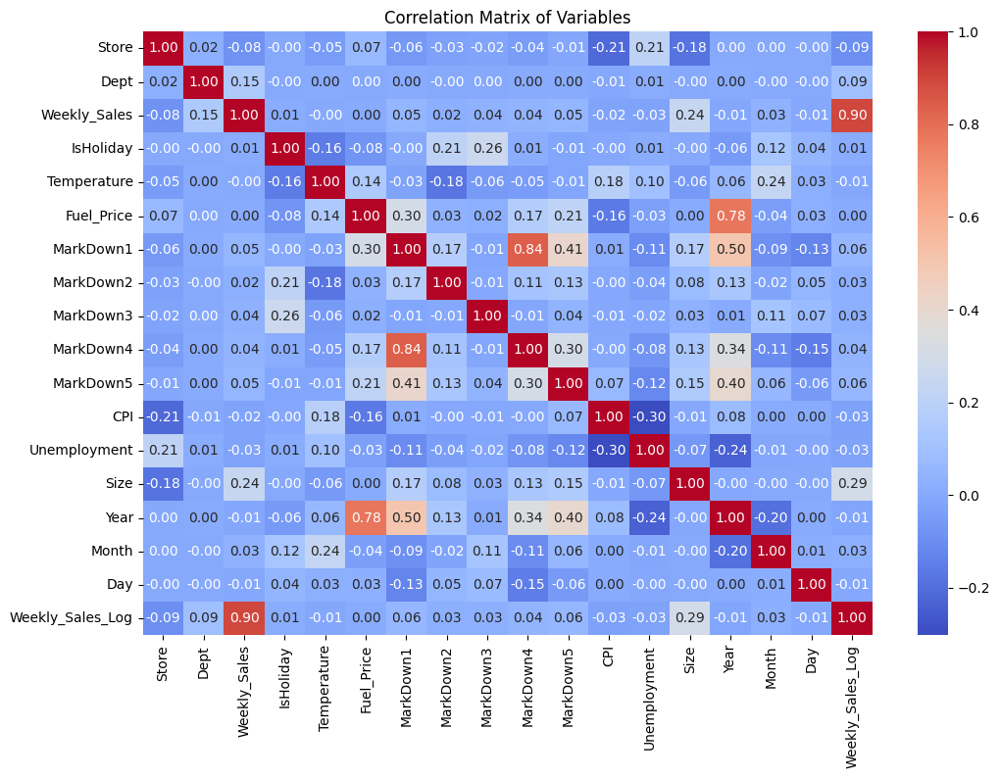

In [ ]:
# Calculate correlation matrix for numerical variables
correlation_matrix = df.corr()

# Plot the correlation matrix using a heatmap in seaborn for better visualization
import seaborn as sns

plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap='coolwarm')
plt.title('Correlation Matrix of Variables')
plt.show()


## Feature Selection

In [ ]:
# Assuming 'correlation_matrix' is your correlation matrix dataframe

# Select features with a significant correlation to Weekly_Sales
# Set a threshold for selection, for example, 0.1
threshold = 0.1
features = correlation_matrix.index[(correlation_matrix['Weekly_Sales'].abs() > threshold) & (correlation_matrix.index != 'Weekly_Sales')].tolist()

# Avoid multicollinearity by removing features that are highly correlated with each other
# This is a simple way to do it, by removing features that have any correlation above a certain level with any other feature
for feature in features:
    if any(correlation_matrix[feature].abs().drop(feature) > 0.75):
        features.remove(feature)

# The remaining 'features' list contains the selected features for modeling
print("Selected features for modeling:", features)


Selected features for modeling: ['Dept', 'Size']


## Regression Model

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error

# Assuming 'df' is your preprocessed dataframe
X = df[['Dept', 'Size']]  # Independent variables
y = df['Weekly_Sales']    # Dependent variable

# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=0)

# Initialize the Linear Regression model
regressor = LinearRegression()

# Fit the model on the training data
regressor.fit(X_train, y_train)

# Predict on the test data
y_pred = regressor.predict(X_test)

# Calculate the Mean Squared Error (MSE) for the test set
mse = mean_squared_error(y_test, y_pred)
print(f"Mean Squared Error: {mse}")

# The coefficients
print(f"Coefficients: {regressor.coef_}")

# You can also look at the R-squared value to see how well the model is fitting the data
r2_score = regressor.score(X_test, y_test)
print(f"R-squared: {r2_score}")


Mean Squared Error: 0.9229030234945587
Coefficients: [4.8672386e-03 4.0252116e-06]
R-squared: 0.07820102327987


## Random Forest

In [ ]:
from sklearn.ensemble import RandomForestRegressor

# Initialize the Random Forest Regressor
rf_regressor = RandomForestRegressor(n_estimators=100, random_state=0)

# Fit the regressor on the training data
rf_regressor.fit(X_train, y_train)

# Predict on the test data
y_pred_rf = rf_regressor.predict(X_test)

# Calculate the Mean Squared Error (MSE) for the test set predictions
mse_rf = mean_squared_error(y_test, y_pred_rf)
print(f"Random Forest Mean Squared Error: {mse_rf}")

# Calculate the R-squared score
r2_score_rf = rf_regressor.score(X_test, y_test)
print(f"Random Forest R-squared: {r2_score_rf}")


Random Forest Mean Squared Error: 0.1070370899117789
Random Forest R-squared: 0.8930909559942946


## Hyperparameter Tuning

In [ ]:
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import RandomForestRegressor

# Define the parameter distribution rather than a parameter grid
param_dist = {
    'n_estimators': [100, 200, 300],
    'max_depth': [10, 20, None],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
}

# Initialize the Randomized Search model
random_search = RandomizedSearchCV(estimator=RandomForestRegressor(random_state=0),
                                   param_distributions=param_dist, n_iter=10, cv=3,
                                   verbose=2, random_state=0, n_jobs=-1)

# Fit the random search to the data
random_search.fit(X_train, y_train)

# Print the best parameters found
print("Best parameters found: ", random_search.best_params_)

# Use the best estimator to make predictions
best_rf_random = random_search.best_estimator_
y_pred_best_rf_random = best_rf_random.predict(X_test)

# Calculate the new MSE and R-squared values
mse_best_rf_random = mean_squared_error(y_test, y_pred_best_rf_random)
r2_score_best_rf_random = best_rf_random.score(X_test, y_test)
print(f"Optimized Random Forest Mean Squared Error (Random Search): {mse_best_rf_random}")
print(f"Optimized Random Forest R-squared (Random Search): {r2_score_best_rf_random}")


Fitting 3 folds for each of 10 candidates, totalling 30 fits
Best parameters found:  {'n_estimators': 200, 'min_samples_split': 10, 'min_samples_leaf': 1, 'max_depth': None}
Optimized Random Forest Mean Squared Error (Random Search): 0.10702659684399013
Optimized Random Forest R-squared (Random Search): 0.8931014365094778


## Analysing Features

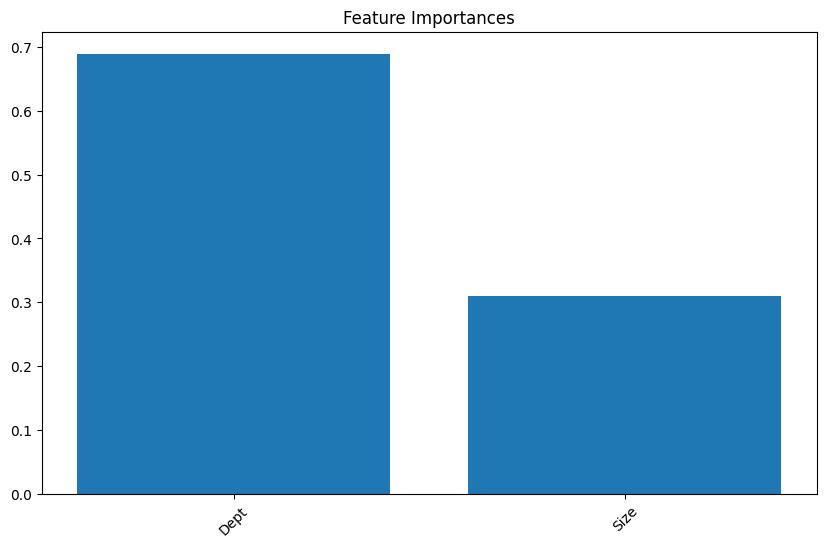

In [23]:
importances = best_rf_random.feature_importances_
feature_names = X_train.columns

# Sort feature importances in descending order
indices = np.argsort(importances)[::-1]

# Rearrange feature names so they match the sorted feature importances
sorted_feature_names = [feature_names[i] for i in indices]

# Visualize the feature importances
plt.figure(figsize=(10, 6))
plt.title("Feature Importances")
plt.bar(range(X_train.shape[1]), importances[indices])
plt.xticks(range(X_train.shape[1]), sorted_feature_names, rotation=45)
plt.show()


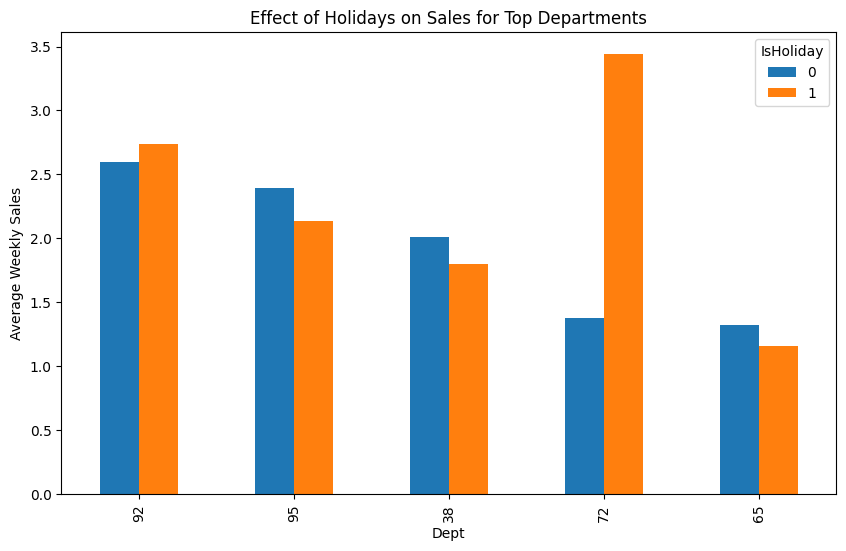

In [24]:
# Group the dataset by 'Dept' and calculate summary statistics for weekly sales
dept_sales_summary = df.groupby('Dept')['Weekly_Sales'].agg(['mean', 'median', 'std', 'max', 'min'])

# Identify departments with the highest average sales
top_departments_by_sales = dept_sales_summary.sort_values(by='mean', ascending=False).head()

# Analyze the effect of holidays on department sales
holiday_sales_comparison = df.groupby(['Dept', 'IsHoliday'])['Weekly_Sales'].mean().unstack()

# Visualize the effect of holidays on sales for top departments
import matplotlib.pyplot as plt

top_depts = top_departments_by_sales.index[:5]  # Top 5 departments
holiday_sales_comparison.loc[top_depts].plot(kind='bar', figsize=(10,6))
plt.title('Effect of Holidays on Sales for Top Departments')
plt.ylabel('Average Weekly Sales')
plt.show()


In [25]:
import plotly.express as px

# Assume 'df' is your full dataframe with all the data already loaded.
# Categorize store size
df['Size_Category'] = pd.cut(df['Size'],
                             bins=[0, 100000, 150000, float('inf')],
                             labels=['Small', 'Medium', 'Large'])

# Create the box plot for the entire dataframe
fig = px.box(df, x='Size_Category', y='Weekly_Sales', color='Size_Category',
             title='Sales Distribution by Store Size Category')

# Show the figure
fig.show()


In [26]:
import plotly.express as px

# Calculate the average weekly sales for holiday vs. non-holiday weeks by department
holiday_sales = df.groupby(['Dept', 'IsHoliday'])['Weekly_Sales'].mean().reset_index()

# Create the bar chart
fig = px.bar(holiday_sales, x='Dept', y='Weekly_Sales', color='IsHoliday',
             barmode='group', title='Average Weekly Sales: Holiday vs Non-Holiday')

# Make the figure interactive and show it
fig.update_layout(xaxis={'categoryorder':'total descending'})
fig.show()


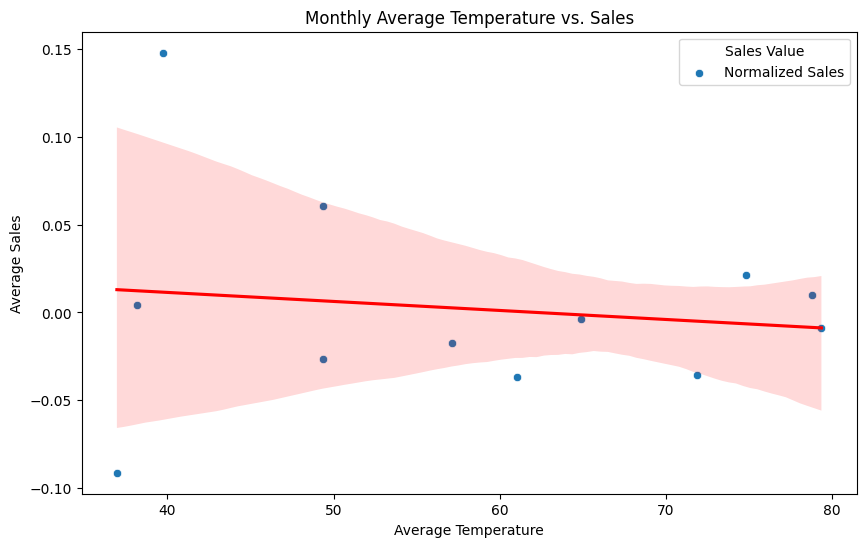

In [27]:
import seaborn as sns
import matplotlib.pyplot as plt

# Aggregate data by temperature range or month, for example:
df['Month'] = pd.to_datetime(df['Date']).dt.month
monthly_avg = df.groupby('Month').agg({'Weekly_Sales':'mean', 'Temperature':'mean'}).reset_index()

# Plot Temperature vs. Sales
plt.figure(figsize=(10, 6))
sns.scatterplot(x='Temperature', y='Weekly_Sales', data=monthly_avg)
sns.regplot(x='Temperature', y='Weekly_Sales', data=monthly_avg, scatter=False, color='red')

plt.title('Monthly Average Temperature vs. Sales')
plt.legend(title='Sales Value', labels=['Normalized Sales'])

plt.xlabel('Average Temperature')
plt.ylabel('Average Sales')
plt.show()


In [28]:
import plotly.express as px
import plotly.graph_objs as go
import numpy as np

# Assume df is your DataFrame with 'Fuel_Price' and 'Weekly_Sales' loaded
# Calculate the trend line (linear fit)
slope, intercept = np.polyfit(df['Fuel_Price'], df['Weekly_Sales'], 1)
df['trend'] = slope * df['Fuel_Price'] + intercept

# Create the scatter plot with Plotly Express
fig = px.scatter(df, x='Fuel_Price', y='Weekly_Sales', title='Impact of Fuel Price on Weekly Sales')

# Add the trend line to the plot using Plotly's graph objects
fig.add_trace(go.Scatter(x=df['Fuel_Price'], y=df['trend'], name='Trend Line', mode='lines', line=dict(color='red')))

# Show the figure
fig.show()


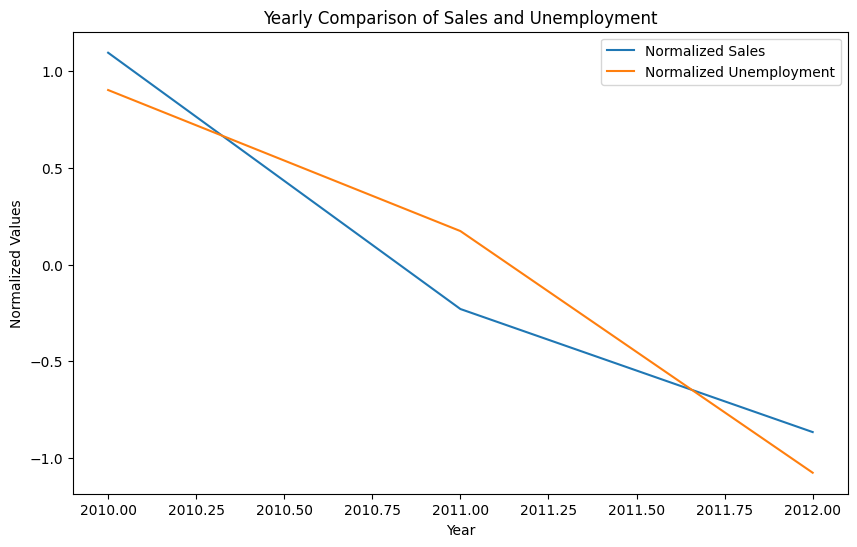

In [29]:
import matplotlib.pyplot as plt
import pandas as pd

# Ensure 'Date' is a datetime column
df['Date'] = pd.to_datetime(df['Date'])
df['Year'] = df['Date'].dt.year

# Aggregate data by year
yearly_data = df.groupby('Year').agg({
    'Weekly_Sales': 'mean',
    'CPI': 'mean',
    'Unemployment': 'mean'
}).reset_index()

# Normalize the data
yearly_data['Normalized_Sales'] = (yearly_data['Weekly_Sales'] - yearly_data['Weekly_Sales'].mean()) / yearly_data['Weekly_Sales'].std()

yearly_data['Normalized_Unemployment'] = (yearly_data['Unemployment'] - yearly_data['Unemployment'].mean()) / yearly_data['Unemployment'].std()

# Plot the normalized metrics
plt.figure(figsize=(10, 6))
plt.plot(yearly_data['Year'], yearly_data['Normalized_Sales'], label='Normalized Sales')

plt.plot(yearly_data['Year'], yearly_data['Normalized_Unemployment'], label='Normalized Unemployment')

# Add labels and legend
plt.xlabel('Year')
plt.ylabel('Normalized Values')
plt.title('Yearly Comparison of Sales and Unemployment')
plt.legend()
plt.show()
